# Data Analysis of children obesity rates in England for GSST

### Background & Objectives

The Guy's and St Thomas' Charity is an independent, place-based foundation working to improve the health of people in the London boroughs of Lambeth and Southwark.

The aim of this project is for Guy’s & St Thomas’ Charity to understand where to target its resources and which areas to fund in the London boroughs of Lambeth and Southwark, to help childhood obesity levels and its effects. This will involve:

* identifying places most (and least) affected by childhood obesity
* identifying who lives in the areas, using a range of socio demographic data
* identifying what the contributing factors are. e.g. by exploring pollutant concentration levels, emissions data and sources of emissions with a particular focus on traffic and time
* identifying how the childhood obesity has evolved over time
* Identifying neighborhoods across the UK that have similar characteristics to neighborhoods in Lambeth and Southwark with high obesity rates.

Throughout this notebook, we will be referring to statistical areas as LAs and MSOAs. LAs are Local Authority Districts and each one contains several MSOAs (Middle Layer Super Output Areas).

We have two datasets containing obesity rates data, each representing a stage of the UK national school curriculum. **Reception** relates to children aged between 4 and 5 years, **Year 6** relates to children between 10 and 11 years old.

In [1]:
from IPython.core.interactiveshell import InteractiveShell
#InteractiveShell.ast_node_interactivity = "all"
import numpy as np
import pandas as pd
from matplotlib import pyplot as plt

import geopandas as gpd
import json
import plotly.express as px
import plotly.graph_objects as go

# ignore warnings
import warnings
warnings.filterwarnings('ignore')

## Part 1: Finding insights in the obesity rate dataset

By looking at the obesity data alone, we should be able to answer the following questions posed by the Guy's and St Thomas' charity:

* identifying places most (and least) affected by childhood obesity
* identifying how childhood obesity has evolved over time

### 1. Inspecting and cleaning the data

In [2]:
# load obesity datasets into dataframes
reception = pd.read_csv('Reception_obesity_rates.csv')
year6 = pd.read_csv('Year6_obesity_rates.csv')

In [3]:
# inspect obesity datasets
reception.head()
year6.head()

# check both have the same number of rows
len(reception.index) 
len(year6.index)

# checking data types
reception.dtypes
year6.dtypes

MSOA name                 object
LA name                   object
2008/09 to 2010/11 | %    object
2009/10 to 2011/12 | %    object
2010/11 to 2012/13 | %    object
2011/12 to 2013/14 | %    object
2012/13 to 2014/15 | %    object
2013/14 to 2015/16 | %    object
2014/15 to 2016/17 | %    object
2015/16 to 2017/18 | %    object
dtype: object

In [4]:
# Renaming columns for ease of reference

reception.columns = ['MSOA', 'LA', '08_09to10_11', '09_10to11_12', '10_11to12_13',
                    '11_12to13_14', '12_13to14_15', '13_14to15_16', '14_15to16_17', '15_16to17_18']

year6.columns = ['MSOA', 'LA', '08_09to10_11', '09_10to11_12', '10_11to12_13',
                    '11_12to13_14', '12_13to14_15', '13_14to15_16', '14_15to16_17', '15_16to17_18']

In [5]:
# Inspect for empty values

reception.isnull().sum()
year6.isnull().sum()

MSOA            0
LA              0
08_09to10_11    0
09_10to11_12    0
10_11to12_13    0
11_12to13_14    0
12_13to14_15    0
13_14to15_16    0
14_15to16_17    0
15_16to17_18    0
dtype: int64

There are no null values in the dataframe

In [6]:
# Inspect for non digit values and create a list of values to be fixed

def find_notvalid(df):
    valid = ['1','2','3','4','5','6','7','8','9','0','.']
    not_valid = []
    for i in range(0,len(df.index)):
        for string in pd.Series(df.values[i]):
            for char in string:
                if char not in valid and char not in not_valid:
                    not_valid.append(string)
    return not_valid


reception_rates = reception[['08_09to10_11', '09_10to11_12', '10_11to12_13',
                    '11_12to13_14', '12_13to14_15', '13_14to15_16', '14_15to16_17', '15_16to17_18']]
year6_rates = year6[['08_09to10_11', '09_10to11_12', '10_11to12_13',
                    '11_12to13_14', '12_13to14_15', '13_14to15_16', '14_15to16_17', '15_16to17_18']]

find_notvalid(reception_rates)
find_notvalid(year6_rates)

['s']

The only invalid values found are the 's' string. All occurences of 's' need to be replaced by a null value, so they can be ignored when aggregate operations are performed on the data.

In [7]:
# Replacing any occurrence of 's' by NaN and converting to float data type.

def fixing_values(df):
    for column in df.columns[2:]:
        df[column] = df[column].str.replace("s","",regex=True)
        df[column] = pd.to_numeric(df[column])
    return

fixing_values(reception)
fixing_values(year6)

In [8]:
# Save updated dataframes to csv
reception.to_csv('reception_cleaned.csv')
year6.to_csv('year6_cleaned.csv')

### 2. Exploratory Analysis

In [9]:
year6.describe().T

,count,mean,std,min,25%,50%,75%,max
08_09to10_11,6685.0,18.401107,4.869714,3.4,14.9,18.4,21.8,34.5
09_10to11_12,6688.0,18.647832,5.024583,3.8,15.0,18.5,22.1,38.8
10_11to12_13,6683.0,18.663280,5.105576,3.4,15.1,18.5,22.3,38.7
11_12to13_14,6700.0,18.632463,5.219945,3.6,14.8,18.6,22.4,39.7
12_13to14_15,6696.0,18.541935,5.337800,4.0,14.7,18.5,22.4,38.4
13_14to15_16,6716.0,18.795905,5.498698,3.7,14.7,18.8,22.8,38.8
14_15to16_17,6725.0,18.997948,5.691094,4.1,14.7,18.9,23.1,36.8
15_16to17_18,6727.0,19.287127,5.766537,2.8,14.9,19.2,23.4,40.9


In [10]:
list(year6.describe().T['mean'])

[18.401106955871352,
 18.647831937799044,
 18.663279964087987,
 18.632462686567163,
 18.54193548387097,
 18.795905300774272,
 18.997947955390334,
 19.287126505128587]

In [11]:
reception.describe().T

,count,mean,std,min,25%,50%,75%,max
08_09to10_11,6530.0,9.492129,2.942258,2.3,7.4,9.3,11.4,22.2
09_10to11_12,6549.0,9.421759,2.950302,2.4,7.2,9.2,11.4,24.4
10_11to12_13,6585.0,9.213637,2.907011,2.3,7.0,9.1,11.2,23.4
11_12to13_14,6578.0,9.227075,2.874164,1.7,7.1,9.0,11.1,22.5
12_13to14_15,6564.0,9.103519,2.820715,2.2,7.0,8.9,11.0,21.5
13_14to15_16,6578.0,9.112496,2.842729,2.2,7.0,9.0,11.1,20.3
14_15to16_17,6617.0,9.135303,2.858436,2.2,7.0,8.9,11.1,21.7
15_16to17_18,6609.0,9.268740,2.917989,2.1,7.1,9.2,11.2,20.7


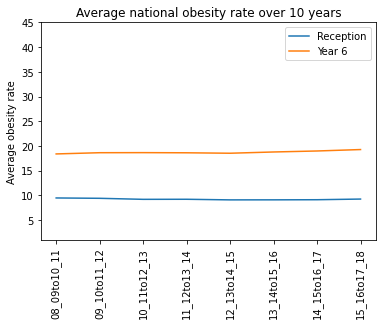

In [12]:
# Plot the national means over the time periods

ax = plt.subplot()
plt.plot(reception.columns[2:],list(reception.describe().T['mean']));
plt.plot(reception.columns[2:],list(year6.describe().T['mean']));
plt.ylim( ymin=1, ymax=45) 
ax.set_xticks(range(len(reception.columns[2:])))
ax.set_xticklabels(reception.columns[2:], rotation=90)
plt.title('Average national obesity rate over 10 years');
plt.ylabel('Average obesity rate');
plt.legend(['Reception', 'Year 6'])
plt.show()

#### Observations:
    - There is very little variation of the average obesity rate country-wide over the period 2008 to 2018
    - There must be a lot of variation between the different areas, as the obesity rates range between around 2% to 24% for Reception age children and between 3% and 41% for Year 6 children, with average standard deviations of approx. 2.9 and 5 respectively.
    - Overall the obesity rates for Year 6 children are significantly higher than for the Reception children. (The median obesity rates for Year 6 children are consistently double those of Reception children)
    - The difference in standard deviation between the two age groups also indicates that the Year 6 children obesity rate is more widely distributed.
    - The range of obesity rates for Year 6 children has broadened over time, suggesting that inequalities may have worsened over the time period.

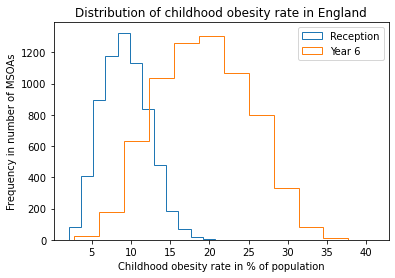

In [13]:
# Visualise distribution of obesity rate over the country for time period 2015/16 to 2017/18

values1 = reception['15_16to17_18']
values2 = year6['15_16to17_18']
plt.hist(values1, bins=12, histtype='step')
plt.hist(values2, bins=12, histtype='step')
plt.title('Distribution of childhood obesity rate in England')
plt.xlabel('Childhood obesity rate in % of population')
plt.ylabel('Frequency in number of MSOAs')
plt.legend(['Reception', 'Year 6'])
plt.show()

#### Observations:
    - The data for both age groups is normally distributed, however it is significantly more widely distributed for Year 6 children.

#### Questions raised for later investigation:
    - is there a proportional growth in obesity rate in each area between reception and year 6? Or does this vary by area?

### 2.1. Identifying places most (and least) affected by childhood obesity

In order to determine whether we need to look at areas at the LA or MSOA level, we first need to establish whether there is a high variance within each LA.

In [14]:
# Calculate standard deviations within each LA
reception.groupby('LA').std()

,08_09to10_11,09_10to11_12,10_11to12_13,11_12to13_14,12_13to14_15,13_14to15_16,14_15to16_17,15_16to17_18
LA,,,,,,,,
Adur,2.094721,1.666423,1.390722,1.810880,2.120605,2.916333,2.975825,1.929424
Allerdale,2.330951,1.793993,1.951903,1.794605,2.514262,3.571382,3.260078,3.102333
Amber Valley,2.218408,2.491853,1.863677,1.880452,2.186623,2.599968,2.611513,2.138224
Arun,2.947020,3.022574,2.444908,2.730412,2.387236,2.806915,1.930826,1.890942
Ashfield,3.598698,2.650316,2.479587,2.653041,1.582074,1.657294,1.997989,1.957539
...,...,...,...,...,...,...,...,...
Wychavon,3.053423,2.820425,2.328680,2.059666,2.146383,2.003564,1.983779,2.011153
Wycombe,3.013579,3.154938,2.595215,2.696536,2.717394,2.416043,1.936393,1.923405
Wyre,1.685165,1.260908,2.285129,2.639930,2.786397,2.744155,1.870770,2.515796


In [15]:
year6.groupby('LA').std()

,08_09to10_11,09_10to11_12,10_11to12_13,11_12to13_14,12_13to14_15,13_14to15_16,14_15to16_17,15_16to17_18
LA,,,,,,,,
Adur,4.115476,3.602752,3.613837,3.245216,3.266715,2.982778,3.663332,3.352611
Allerdale,5.221169,5.745486,5.333506,4.431798,4.534180,4.876373,5.346848,5.077662
Amber Valley,3.826661,4.027649,4.254287,4.910923,5.088353,4.848604,5.418856,4.808946
Arun,4.551383,5.140045,5.195601,5.629912,4.958052,4.793630,3.473810,3.606459
Ashfield,3.869964,3.723618,3.469678,3.169746,2.672132,3.020479,2.861519,3.982127
...,...,...,...,...,...,...,...,...
Wychavon,3.453399,3.221429,4.350076,4.207443,3.861067,3.839857,4.943494,4.310310
Wycombe,3.464478,3.763203,4.026822,4.297977,4.488567,5.199384,5.082528,5.001209
Wyre,4.322342,4.326916,3.822095,4.347723,3.924255,4.190413,3.759011,3.294751


There is a high level of variance within each LA, almost as high as the variance at the national level.

As a result, it doesn't make sense to aggregate at the LA level, and we will look for the areas most and least affected at the MSOA level.

**Dealing with missing values**

We need to make a decision regarding the criteria to be applied to determine most and least affected areas.
I initially thought we could use the rates from the most recent column, however because of the missing data in that column, we run the risk of omitting certain areas that would otherwise be in need of funding.

In order to help with a decision, we can first examine the areas with missing values in the most recent time period available for each dataset.

In [16]:
reception[reception['15_16to17_18'].isnull()]

,MSOA,LA,08_09to10_11,09_10to11_12,10_11to12_13,11_12to13_14,12_13to14_15,13_14to15_16,14_15to16_17,15_16to17_18
43,Arun 008,Arun,NaN,NaN,NaN,9.5,9.4,7.8,NaN,NaN
53,Arun 018,Arun,14.6,13.9,9.5,6.6,5.2,4.7,NaN,NaN
87,Aylesbury Vale 003,Aylesbury Vale,11.8,10.4,8.3,6.5,5.2,4.9,4.9,NaN
107,Aylesbury Vale 023,Aylesbury Vale,11.5,9.6,9.9,6.4,7.2,4.7,5.3,NaN
283,Bath and North East Somerset 003,Bath and North East Somerset,NaN,NaN,NaN,8.7,10.6,6.5,5.8,NaN
...,...,...,...,...,...,...,...,...,...,...
6407,Westminster 012,Westminster,11.1,13.1,11.6,11.3,9.2,7.5,NaN,NaN
6413,Westminster 018,Westminster,NaN,NaN,NaN,11.9,11.5,NaN,NaN,NaN
6414,Westminster 019,Westminster,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6768,York 002,York,4.0,5.7,7.7,9.5,8.7,7.1,4.6,NaN


In [17]:
year6[year6['15_16to17_18'].isnull()]

,MSOA,LA,08_09to10_11,09_10to11_12,10_11to12_13,11_12to13_14,12_13to14_15,13_14to15_16,14_15to16_17,15_16to17_18
288,Bath and North East Somerset 008,Bath and North East Somerset,10.1,10.6,9.5,8.2,7.4,5.1,4.3,NaN
289,Bath and North East Somerset 009,Bath and North East Somerset,NaN,NaN,NaN,14.9,13.9,10.1,NaN,NaN
482,Birmingham 135,Birmingham,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
485,Birmingham 138,Birmingham,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
611,Bournemouth 023,Bournemouth,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
6260,Waverley 017,Waverley,11.4,NaN,NaN,9.2,9.0,10.1,7.1,NaN
6396,Westminster 001,Westminster,26.1,21.9,18.8,NaN,NaN,NaN,NaN,NaN
6403,Westminster 008,Westminster,NaN,NaN,NaN,17.6,16.0,23.5,NaN,NaN
6406,Westminster 011,Westminster,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [18]:
# Check for missing values for Lamberth and Southwark in Reception dataset
reception[(reception['15_16to17_18'].isnull()) & ((reception.LA == 'Southwark') | (reception.LA == 'Lambeth'))].sum()

MSOA            0.0
LA              0.0
08_09to10_11    0.0
09_10to11_12    0.0
10_11to12_13    0.0
11_12to13_14    0.0
12_13to14_15    0.0
13_14to15_16    0.0
14_15to16_17    0.0
15_16to17_18    0.0
dtype: float64

In [19]:
# Check for missing values for Lamberth and Southwark in Year 6 dataset
year6[(year6['15_16to17_18'].isnull()) & ((year6.LA == 'Southwark') | (year6.LA == 'Lambeth'))].sum()

MSOA            0.0
LA              0.0
08_09to10_11    0.0
09_10to11_12    0.0
10_11to12_13    0.0
11_12to13_14    0.0
12_13to14_15    0.0
13_14to15_16    0.0
14_15to16_17    0.0
15_16to17_18    0.0
dtype: float64

The Reception dataset has 261 instances with missing values in the most recent time period.
The year 6 dataset has 64 instances with missing values in the most recent time period.

These numbers make it impractical to look at each case to replace each individual missing value. A number of rules must be devised to replace these by more meaningful values:

- Any instances with missing values in all 3 most recent periods will be left as is. They will be ignored in the aggregations and rankings, which is suitable as we cannot derive any information that would be useful to GSST from those instances.
- If there is an upward or downward trend in the rates for an instance, we will use the more recent available rate to replace the missing value.
- If the values avalaible for an instance are irregular (i.e. no strict upward or downward trend), we will use an average of all available rates to replace the missing value.

There are no missing values for the most recent time period for any MSOAs in Lambeth or Southwark.

In [20]:
# Add a column to use for calculations/ranking of least and most affected in the country

def add_ranking_col(df):
    
    for i in range(0, len(df.index)):
        down_trend = df.at[i, '08_09to10_11'] >= df.at[i, '09_10to11_12'] >= df.at[i, '10_11to12_13'] \
    >= df.at[i, '11_12to13_14'] >= df.at[i, '12_13to14_15'] >= df.at[i, '13_14to15_16'] \
    >= df.at[i, '14_15to16_17']
    
        up_trend = df.at[i, '08_09to10_11'] <= df.at[i, '09_10to11_12'] <= df.at[i, '10_11to12_13'] \
    <= df.at[i, '11_12to13_14'] <= df.at[i, '12_13to14_15'] <= df.at[i, '13_14to15_16'] \
    <= df.at[i, '14_15to16_17']

        if np.isnan(df.at[i,'15_16to17_18']):
            if np.isnan(df.at[i, '14_15to16_17']) and np.isnan(df.at[i, '13_14to15_16']):
                df.at[i, 'rate_for_rank'] = np.nan
            elif (down_trend or up_trend) and not np.isnan(df.at[i, '14_15to16_17']):
                df.at[i,'rate_for_rank'] = df.at[i,'14_15to16_17']
            elif (down_trend or up_trend) and not np.isnan(df.at[i, '13_14to15_16']):
                df.at[i,'rate_for_rank'] = df.at[i,'13_14to15_16']
            else:
                df.at[i,'rate_for_rank'] = np.nanmean([df.at[i, '08_09to10_11'], \
                                                       df.at[i, '09_10to11_12'], \
                                                       df.at[i, '10_11to12_13'], \
                                                       df.at[i, '11_12to13_14'], \
                                                       df.at[i, '13_14to15_16'], \
                                                       df.at[i, '14_15to16_17']])
        else:
            df.at[i, 'rate_for_rank'] = df.at[i,'15_16to17_18']
    return

In [21]:
add_ranking_col(year6)
add_ranking_col(reception)

In [22]:
reception

,MSOA,LA,08_09to10_11,09_10to11_12,10_11to12_13,11_12to13_14,12_13to14_15,13_14to15_16,14_15to16_17,15_16to17_18,rate_for_rank
0,Adur 001,Adur,6.2,7.8,9.2,11.7,9.4,7.4,4.4,5.6,5.600000
1,Adur 002,Adur,4.9,6.4,8.3,8.6,7.0,5.4,5.3,6.4,6.400000
2,Adur 003,Adur,4.5,8.0,8.6,9.6,7.2,6.6,7.6,9.2,9.200000
3,Adur 004,Adur,6.1,7.6,9.9,11.1,9.7,9.8,8.3,6.9,6.900000
4,Adur 005,Adur,4.0,5.7,6.7,9.5,6.3,5.4,4.0,4.5,4.500000
...,...,...,...,...,...,...,...,...,...,...,...
6786,York 020,York,7.0,8.2,7.9,7.5,6.0,6.2,6.2,8.7,8.700000
6787,York 021,York,8.8,8.3,7.7,5.0,5.2,5.5,5.7,3.4,3.400000
6788,York 022,York,8.5,6.3,9.7,10.3,10.1,9.0,9.7,13.8,13.800000
6789,York 023,York,10.6,9.1,5.5,8.2,8.3,7.0,4.5,NaN,7.483333


In [23]:
reception['15_16to17_18'].quantile([.05,.95])

0.05     4.7
0.95    14.2
Name: 15_16to17_18, dtype: float64

In [24]:
year6['rate_for_rank'].quantile([.05,.95])

0.05    10.0
0.95    28.8
Name: rate_for_rank, dtype: float64

In [25]:
least_affected_rec = set(reception[reception['rate_for_rank'] < 4.7].MSOA)
len(least_affected_rec)

316

In [26]:
least_affected_y6 = set(year6[year6['rate_for_rank'] < 10].MSOA)
len(least_affected_y6)

325

In [27]:
# Check if there is much correspondence between least affected areas in each age group

least_affected_intersection = least_affected_rec.intersection(least_affected_y6)
len(least_affected_intersection)

96

Surprisingly, only 96 out of the 316 and 325 MSOAs (respectively) are in both least affected MSOAs for each age group. Does this indicate that some areas may struggle more with certain ages? Is it the same for the areas most affected? Do different sociodemographic or environmental conditions affect different age groups differently?

Although the GSST charity would like the analysis to focus on Year 6 data, it would be an interesting question to research at a later date.

In [28]:
most_affected_rec = set(reception[reception['rate_for_rank'] > 14.2].MSOA)
len(most_affected_rec)

317

In [29]:
most_affected_y6 = set(year6[year6['rate_for_rank'] > 28.8].MSOA)
len(most_affected_y6)

325

In [30]:
most_affected_intersection = most_affected_rec.intersection(most_affected_y6)
len(most_affected_intersection)

81

Yes, it appears that the same is true of the areas most affected. Only 81 MSOAs are represented in both age groups. **The GSST charity have stated they would prefer to concentrate on Year 6 data, so this is what we'll focus on, but it's important to note that each age group may be affected by different factors.**

In terms of answering the question posed by the GSTT charity (identifying places in England most and least affected by childhood obesity), we now have lists of MSOAs and these can later be investigated alongside the sociodemographic data to find correlations.

##### Lambeth & Soutwark

As the Guy's & St Thomas' charity are looking to fund projects more specifically in the LAs of Lambeth and Southwark, we need identify MSOAs most and least affected within these 2 LAs, concentrating on Year 6 data and the most recent time period.

*NB: There are many options possible to define the least and most affected, such as averaging over all time periods available, or finding the MSOAs falling in the brackets most often etc... Ideally, I would have consulted the charity to refine and confirm their requirements but as this is not possible here, I've opted to use simply the most recent time period, as the charity is looking for areas to fund right now.*

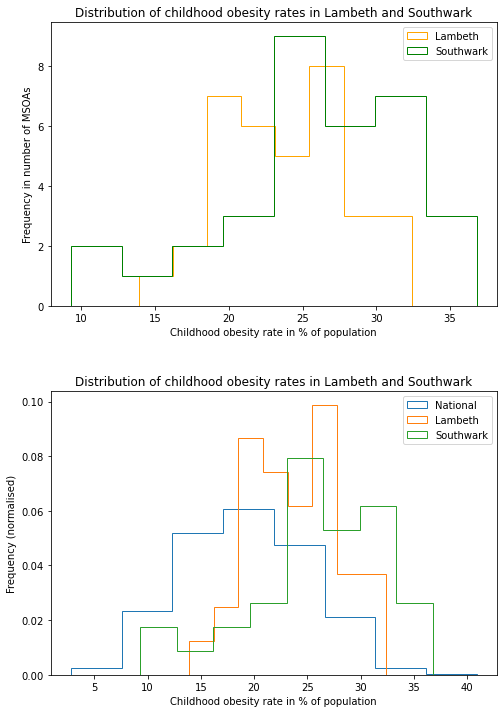

In [31]:
# Visualise the distribution of obesity rates in Lambeth and Southwark and compare with national distribution

lambeth_year6 = year6[year6.LA == 'Lambeth']
southwark_year6 = year6[year6.LA == 'Southwark']

plt.figure(figsize=(8,12))
plt.subplot(2,1,1)
values1 = lambeth_year6['15_16to17_18']
values2 = southwark_year6['15_16to17_18']
plt.hist(values1, bins=8, histtype='step', color='orange')
plt.hist(values2, bins=8, histtype='step', color='green')
plt.title('Distribution of childhood obesity rates in Lambeth and Southwark')
plt.xlabel('Childhood obesity rate in % of population')
plt.ylabel('Frequency in number of MSOAs')
plt.legend(['Lambeth', 'Southwark'])

plt.subplot(2,1,2)
national = year6['15_16to17_18']
values1 = lambeth_year6['15_16to17_18']
values2 = southwark_year6['15_16to17_18']
plt.hist(national, bins=8, histtype='step', density=True)
plt.hist(values1, bins=8, histtype='step', density=True)
plt.hist(values2, bins=8, histtype='step', density=True)
plt.title('Distribution of childhood obesity rates in Lambeth and Southwark')
plt.xlabel('Childhood obesity rate in % of population')
plt.ylabel('Frequency (normalised)')
plt.legend(['National','Lambeth', 'Southwark'])
plt.subplots_adjust(hspace=0.3)
plt.show()

We are now focusing on year 6 as the specific age group of interest to GSST.

**Observations**:
- The distribution for Southwark is skewed left, meaning that there is a higher concentration of high obesity rates in this LA compared to both Lambeth and the national distribution. So it appears Southwark is the most affected out of the two.
- The majority of rates in Lambeth MSOAs are still higher than the national average.

In [32]:
# Find the most and least affected MSOAs within an LA and age group

def find_least_affected(age_group, la, percentile1):
    la_subset_df = age_group[age_group.LA == la]
    q1 = la_subset_df['15_16to17_18'].quantile(percentile1)
    least_affected = list(la_subset_df[la_subset_df['15_16to17_18'] < q1].MSOA)
    return least_affected
    
def find_most_affected(age_group, la, percentile2):
    la_subset_df = age_group[age_group.LA == la]
    q2 = la_subset_df['15_16to17_18'].quantile(percentile2)
    most_affected = list(la_subset_df[la_subset_df['15_16to17_18'] > q2].MSOA)
    return most_affected

In [33]:
find_least_affected(year6, 'Lambeth', 0.1)

['Lambeth 012', 'Lambeth 015', 'Lambeth 018', 'Lambeth 023']

In [34]:
find_most_affected(year6, 'Lambeth', 0.9)

['Lambeth 004', 'Lambeth 007', 'Lambeth 009', 'Lambeth 011']

In [35]:
find_least_affected(year6, 'Southwark', 0.1)

['Southwark 028', 'Southwark 029', 'Southwark 030', 'Southwark 031']

In [36]:
find_most_affected(year6, 'Southwark', 0.9)

['Southwark 010', 'Southwark 014', 'Southwark 020', 'Southwark 021']

The assumption here is that GSST are treating each LA of Southwark and Lambeth individually i.e. they are looking to apportion their funding equally between the two. If that is not the case, then it could be more beneficial to find the most affected MSOAs across both LAs together. From the histogram, it looks like Southwark's most affected are worse affected than Lambeth's and may benefit from more funding, or GSST should fund more MSOAs. In that case, we could use the function below.

In [37]:
def find_most_affected_across2la(age_group, la1, la2, percentile2):
    la_subset_df = age_group[(age_group.LA == la1) | (age_group.LA == la2)]
    q2 = la_subset_df['15_16to17_18'].quantile(percentile2)
    print('{percentile}th percentile is: {q2}' .format(percentile=int(percentile2 * 100), q2=q2))
    #print(la_subset_df['15_16to17_18'])
    most_affected = list(la_subset_df[la_subset_df['15_16to17_18'] > q2].MSOA)
    return most_affected

find_most_affected_across2la(year6, 'Southwark', 'Lambeth', 0.9)

90th percentile is: 31.43


['Lambeth 009',
 'Lambeth 011',
 'Southwark 010',
 'Southwark 014',
 'Southwark 017',
 'Southwark 020',
 'Southwark 021']

As expected from the distribution, the 10% most affected list contains more areas from Southwark than Lambeth.

### 2.2. Geographic visualisation

Displaying the obesity rates on a map of will help visualise the geographic distribution of the issue more clearly and identify problem areas more easily. Since the objective of the study is focused on London areas, we will limit the map to London.

As MSOAs are the lowest level of granularity available in our data, we will use MSOA geographical files to create a Choropleth map. The shape files for London were sourced from https://data.london.gov.uk/dataset/statistical-gis-boundary-files-london.

In [38]:
# Plotly requires a mapbox base map
mapbox_api_key = "pk.eyJ1IjoiYWxpY2Vtb3lvbiIsImEiOiJja2Juc240bG8weTFyMnhwb3VrbzU1OWk4In0.nx7urMH1n84mSzleqAcy6A"
px.set_mapbox_access_token(mapbox_api_key)

In [39]:
# convert shape files into geodataframe
london_msoa_df = gpd.read_file("MSOA_2011_London_gen_MHW") # folder containing the set of shapes files

# Convert coordinates system to suit Plotly
london_msoa_df = london_msoa_df.to_crs(epsg=4326)

In [40]:
type(london_msoa_df)

geopandas.geodataframe.GeoDataFrame

In [41]:
# turn geo data into json format as input to the choropleth
london_msoa_json = json.loads(london_msoa_df.to_json())

One issue here is that our dataset contains data for all MSOAs in the UK, but our map is specific to London MSOAs. So we need to trim our datasets to avoid issues with Plotly.

In [42]:
print(len(london_msoa_json['features']))

983


In [43]:
msoas_included = []

for i in range (0, len(london_msoa_json['features'])):
    msoas_included.append(london_msoa_json["features"][i]["properties"]["MSOA11NM"])
    
reception_london = reception[reception['MSOA'].isin(msoas_included)]

# double check length of dataset
reception_london.shape

(983, 11)

In [44]:
# creating the year6 dataset for London only
y6_london = year6[year6['MSOA'].isin(msoas_included)]
y6_london.shape

(983, 11)

In [45]:
colorbar = dict(title={"text": "obesity rate"}, yanchor="top", y=1, ticks="outside", ticksuffix="%")

# This is a list of dictionaries that each represents a separate Choroplethmapbox object to be layered on the map
# The available properties for Choroplethmapbox objects can be found here https://plotly.com/python/reference/#choroplethmapbox
data = [
    dict(type='choroplethmapbox',
         name='Reception',
         geojson=london_msoa_json,
         locations=reception_london['MSOA'],
         z=reception_london['rate_for_rank'],
         zmin=0, zmax=reception_london['rate_for_rank'].max(),
         featureidkey="properties.MSOA11NM",
         # determines what appears on hover. <extra></extra> prevents the second box from appearing
         hovertemplate="%{location}: %{z}%<extra></extra>",
         colorbar=colorbar,
         autocolorscale=False,
         colorscale="RdYlGn",
         reversescale=True,
         zmid=reception_london['rate_for_rank'].mean(),
        visible=True),
    dict(type='choroplethmapbox',
         name='Year 6',
         geojson=london_msoa_json,
         locations=y6_london['MSOA'],
         z=y6_london['rate_for_rank'],
         zmin=0, zmax=y6_london['rate_for_rank'].max(),
         featureidkey="properties.MSOA11NM",
         hovertemplate="%{location}: %{z}%<extra></extra>",
         colorbar=colorbar,
         autocolorscale=False,
         colorscale="RdYlGn",
         reversescale=True,
         zmid=y6_london['rate_for_rank'].mean(),
         # set to false so that only the Reception data is shown initially, before selection with the dropdown
        visible=False)
]

In [46]:
# Creates the layout object. Full list of properties available can be found here:
# https://plotly.com/python-api-reference/generated/plotly.graph_objects.Layout.html#plotly.graph_objects.Layout

layout = go.Layout(
    title_text = 'Children obesity rates in London MSOAs',
    font = dict(family='Roboto'),
    # top, bottom, left and right margins
    margin = dict(t = 0, b = 0, l = 0, r = 0),
    mapbox = dict(
        # here you need the token from Mapbox
        accesstoken = mapbox_api_key,
        # where we want the map to be centered
        center={"lat": 51.509865, "lon": -0.118092},
        # default level of zoom
        zoom = 9,
        # default map style
        style = 'outdoors'
    ),
)

# each dropdown menu is defined as a dictionary within the list. All available properties for updatemenus objects
# can be found here https://plotly.com/python/reference/#layout-updatemenus

layout.updatemenus = list([
    dict(buttons=list([
        dict(label='Reception', method='update', args=[{'visible': [True, False]}]),
        dict(label='Year 6', method='update', args=[{'visible': [False, True]}])
    ]),
         # placement of dropdown menu on the figure
         direction='down', x = -0.05, xanchor = 'left', y = 1, yanchor = 'top',
         showactive=True
    )
])


In [47]:
interactive_fig = go.Figure(data=data, layout=layout)
interactive_fig.layout.title.text = "Children obesity rates in London MSOAs"
interactive_fig.show()

### 2.3. Evolution over time

### 2.3.1. Visualisations

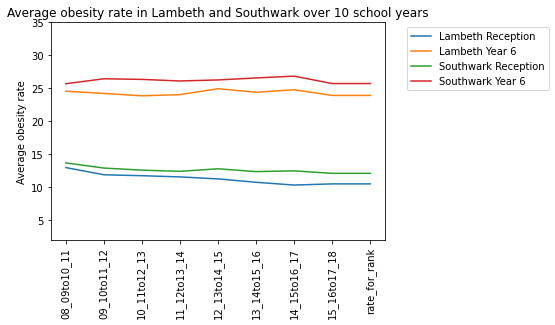

In [48]:
# plot the average obesity rate evolution in Lambeth and Southwark over the year ranges

lambeth_reception = reception[reception.LA == 'Lambeth']
southwark_reception = reception[reception.LA == 'Southwark']
lambeth_year6 = year6[year6.LA == 'Lambeth']
southwark_year6 = year6[year6.LA == 'Southwark']

lambeth_rec_means = []
for column in lambeth_reception.columns[2:]:
    mean = lambeth_reception[column].mean()
    lambeth_rec_means.append(mean)
    
lambeth_y6_means = []
for column in lambeth_year6.columns[2:]:
    mean = lambeth_year6[column].mean()
    lambeth_y6_means.append(mean)

southwark_rec_means = []
for column in southwark_reception.columns[2:]:
    mean = southwark_reception[column].mean()
    southwark_rec_means.append(mean)

southwark_y6_means = []
for column in southwark_year6.columns[2:]:
    mean = southwark_year6[column].mean()
    southwark_y6_means.append(mean)

ax = plt.subplot()
plt.plot(lambeth_reception.columns[2:],lambeth_rec_means)
plt.plot(lambeth_reception.columns[2:],lambeth_y6_means)
plt.plot(southwark_reception.columns[2:],southwark_rec_means)
plt.plot(southwark_reception.columns[2:],southwark_y6_means)
plt.ylim(ymin=2.0, ymax=35) 
ax.set_xticks(range(len(lambeth_reception.columns[2:])))
ax.set_xticklabels(lambeth_reception.columns[2:], rotation=90)
plt.title('Average obesity rate in Lambeth and Southwark over 10 school years')
plt.ylabel('Average obesity rate')
plt.legend(['Lambeth Reception', 'Lambeth Year 6', 'Southwark Reception', 'Southwark Year 6'], bbox_to_anchor=(1.05,1))
plt.show()

It looks as though the overall average obesity rates in Lambeth and Southwark have not changed much over time but as there is much variation within these areas, it is more meaningful to look at the individual timelines for the lower level MSOAs instead.

In [49]:
 # Plot timelines for each MSOA within an LA

def plot_timeline(age_group, la):
    df = age_group[age_group.LA == la]
    plt.figure(figsize=(15, 10))
    ax = plt.subplot()
    msoa_list = list(df.MSOA.unique())
    for msoa in msoa_list:
        df_msoa = df[df.MSOA == msoa].reset_index(drop=True)
        df_msoa = df_msoa[['08_09to10_11', '09_10to11_12', '10_11to12_13','11_12to13_14', \
                                               '12_13to14_15', '13_14to15_16', '14_15to16_17', '15_16to17_18']]
        rates = list(df_msoa.iloc[0].values)
        plt.plot(df_msoa.columns, rates)
    ax.set_xticks(range(len(df_msoa.columns)))
    ax.set_xticklabels(df_msoa.columns, rotation=90)
#    plt.ylim(ymin=2.0, ymax=24)
    plt.title('Obesity rate for children in {} MSOAs over 10 school year periods' .format(la))
    plt.ylabel('Obesity rate')
    plt.legend(msoa_list, bbox_to_anchor=(1.05, 1))

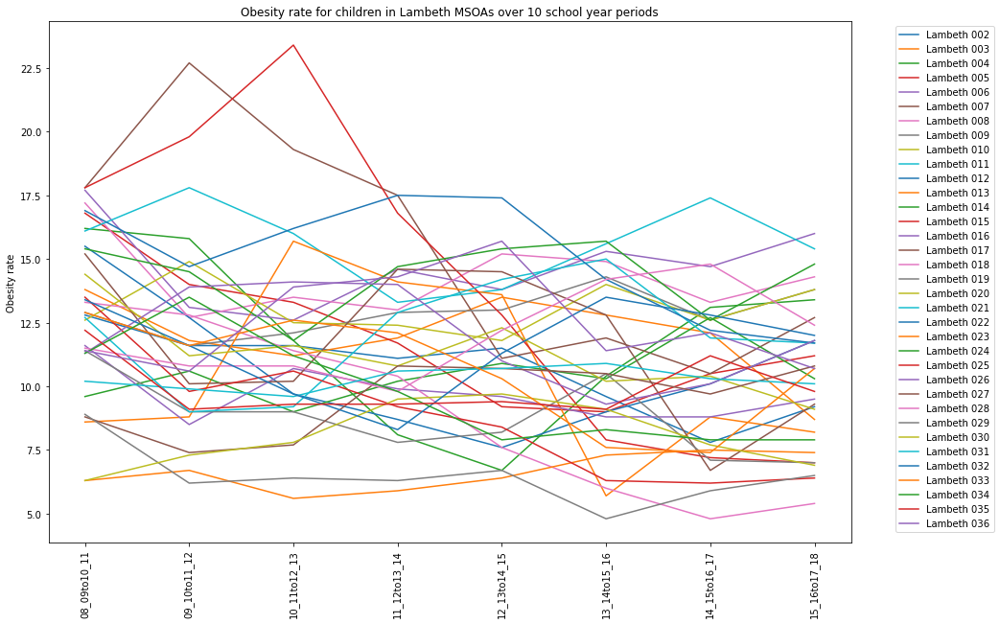

In [50]:
plot_timeline(reception, 'Lambeth')

Given the large number of MSOAs, this chart is too busy to generate any insights from, but we can make the following observations:
- There is no obvious general upward or downward pattern across the LA
- The obesity rates for each MSOA seem to fluctutate over time but generally end up at the same level they started (at frist glance)
- Two lines stand out as particularly interesting. We need to look at individual timelines to identify and isolate them.

In [51]:
# Plot timelines for each MSOA individually

def plot_msoa_timeline(age_group, la):
   
    df = age_group[age_group.LA == la]
    msoa_list = list(df.MSOA.unique())
    i = 1
    
    for msoa in msoa_list:
        df_msoa = df[df.MSOA == msoa].reset_index(drop=True)
        df_msoa = df_msoa[['08_09to10_11', '09_10to11_12', '10_11to12_13','11_12to13_14', \
                                               '12_13to14_15', '13_14to15_16', '14_15to16_17', '15_16to17_18']]
        rates = list(df_msoa.iloc[0].values)
        ax = plt.subplot()
        plt.plot(df_msoa.columns, rates, marker = 'o')
        ax.set_xticks(range(len(df_msoa.columns)))
        ax.set_xticklabels(df_msoa.columns, rotation=90)
        plt.ylim(ymin=2.0, ymax=40)
        plt.title('Obesity rate for children in {} over 10 school year periods' .format(msoa))
        plt.ylabel('Obesity rate')
        i += 1
        plt.show()

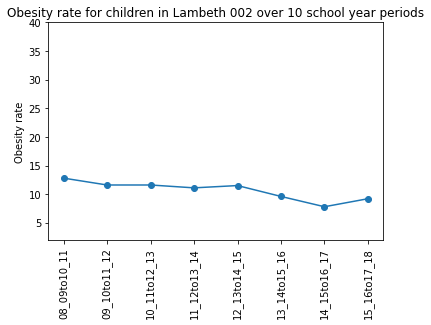

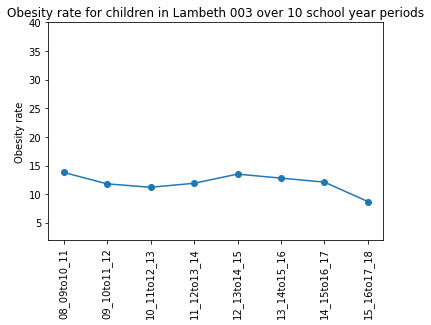

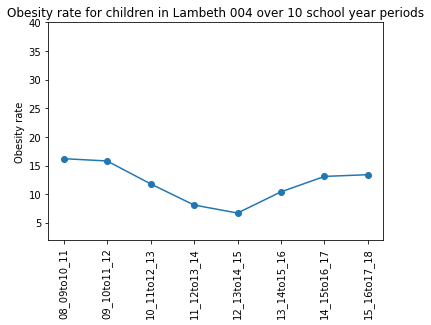

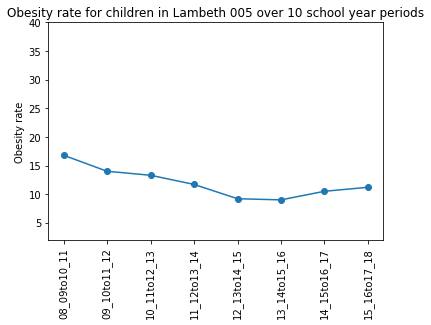

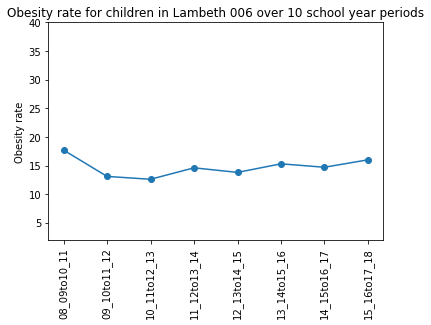

...

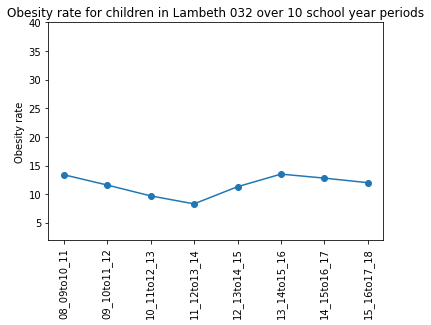

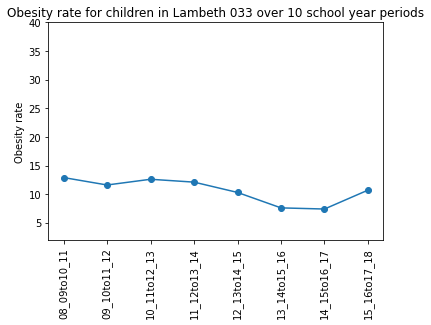

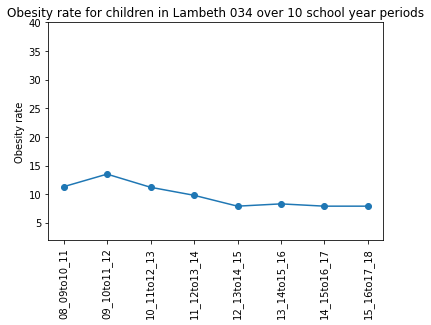

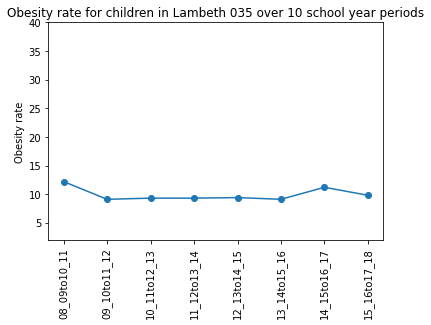

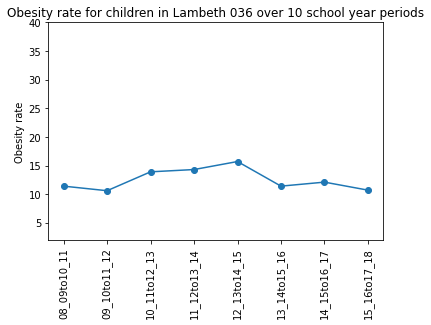

In [52]:
plot_msoa_timeline(reception, 'Lambeth')

#### Observations for Reception age in Lambeth MSOAs:

Individual plots worth noting are:
    - Lambeth 004 had a significant drop during the middle time periods.
    - Lambeth 007 had a significant hike then steep drop
    - Lambeth 015 had the most dramatic drop in the last 6 periods
    - Lambeth 018 and Lambeth 025 had a steady improvement in the obesity rate

Next steps:
    - Confirm if the drops and hikes in Lambeth 004, 007 and 015 are indeed statistically significant or simply due to natural fluctuations. If they are found to be statistically significant then we can look at potential factors/causes.
    - Confirm if the steady improvement in Lambeth 018 and 025 are statistically significant, and investigate potential positive factors that could be applied to other areas.

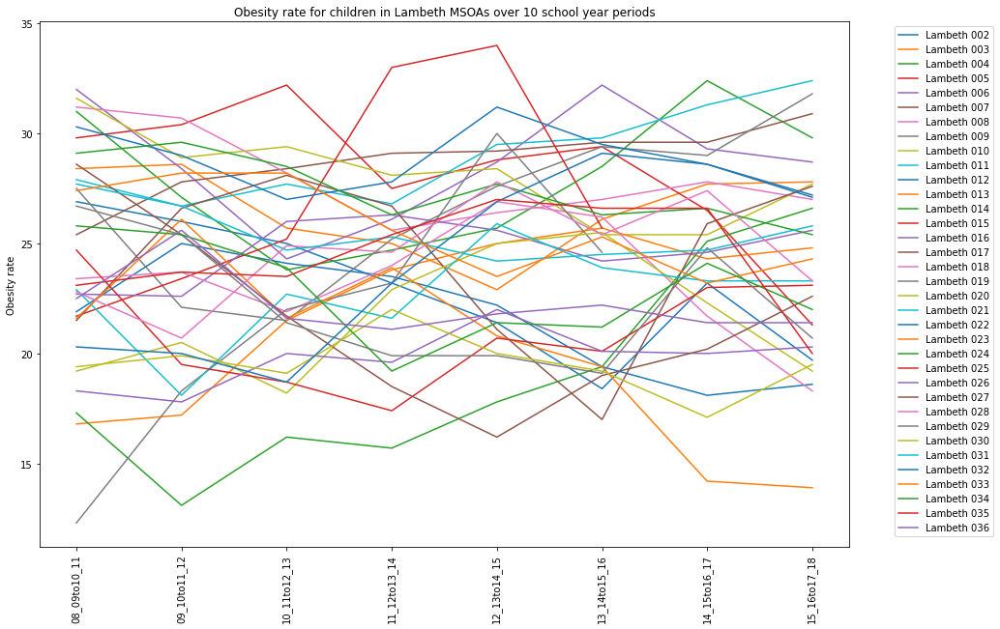

In [53]:
plot_timeline(year6, 'Lambeth')

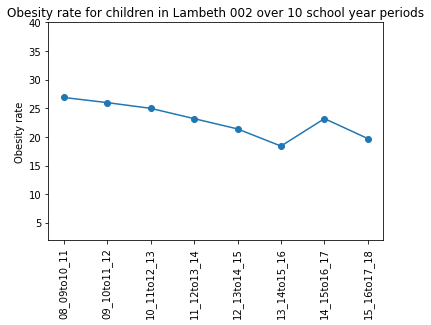

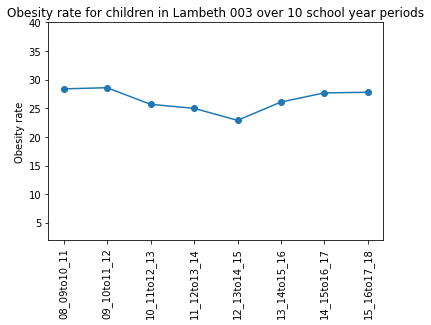

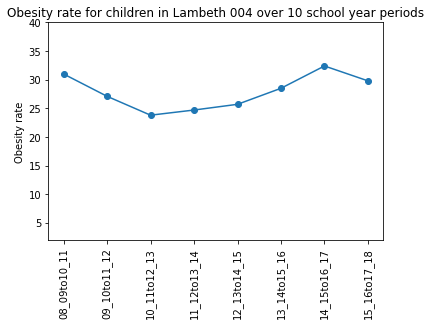

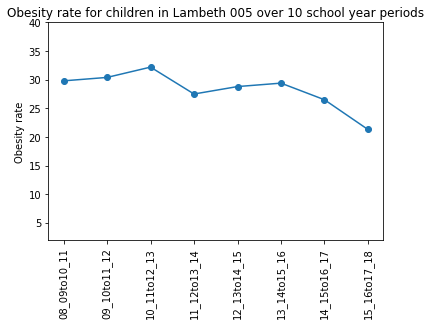

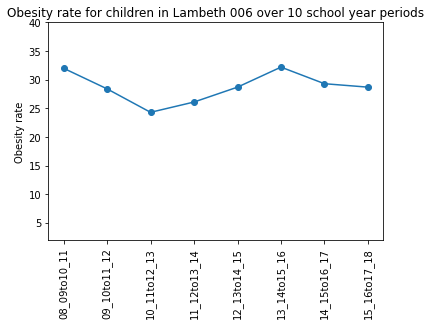

...

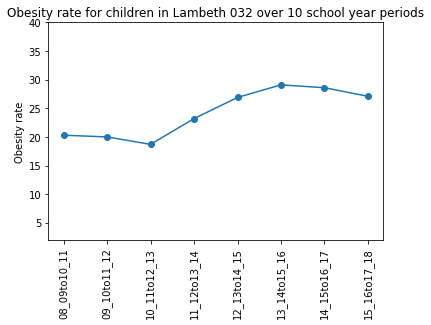

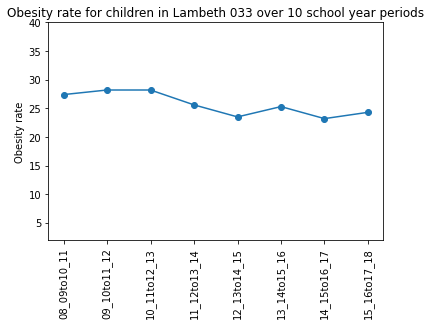

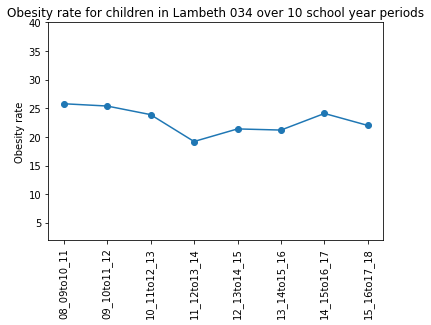

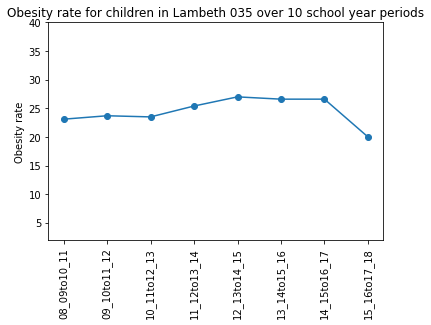

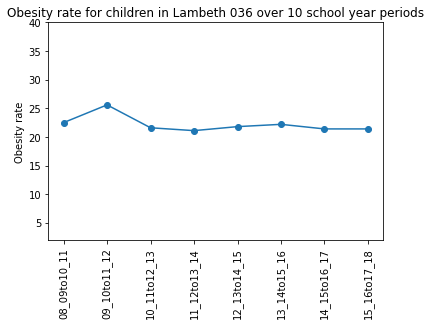

In [54]:
plot_msoa_timeline(year6, 'Lambeth')

#### Observations for Year 6 in Lambeth MSOAs:

Individual plots worth noting are:
    - Lambeth 005 had a steady-ish improvement
    - Lambeth 007, 011, 013, 014 had a steady worsening of the obesity rate
    - We are missing data for the last 2 periods for Lambeth 015 & 019, meaning they will be (possibly wrongly) excluded from the worst affected list and may not receive funding.
    - Lambeth 017 has had wide variations over time
    - Lambeth 019 had significant and steady hike over the first 5 periods
    - Lambeth 027 had a steep and steady decline but the rate has been growing again since period 5.
    - Lambeth 032 has worsened by about 10%

Next steps:
    - Investigate potential factors in the steady improvement of Lambeth 005. They may be reproducible in other areas.
    - Investigate potential factors/causes in the steady worsening of Lambeth 007, 011, 013, 014, 019
    - Investigate if the variations in lambeth 017 are statistically significant and can be attributed to specific factors.
    - Investigate the particularly steep worsening of Lambeth 032

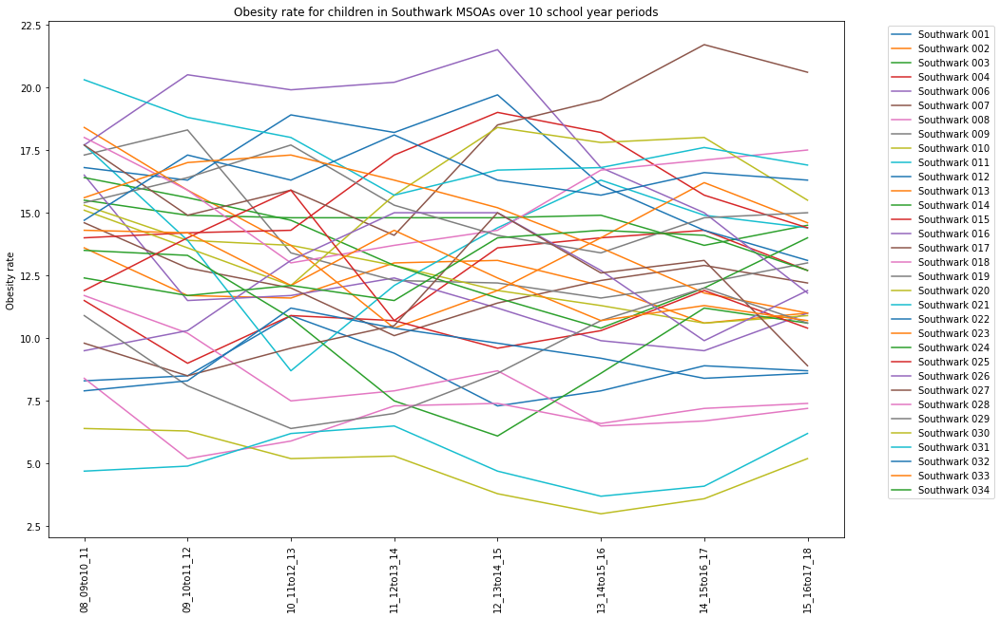

In [55]:
plot_timeline(reception, 'Southwark')

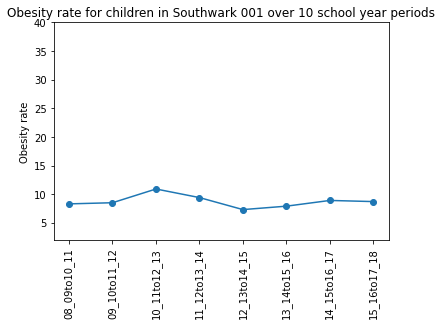

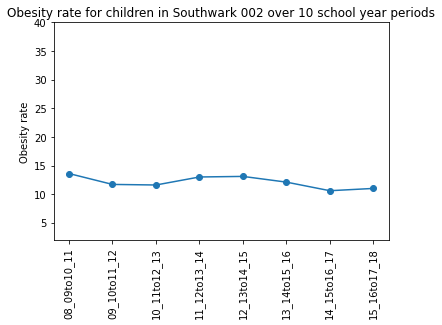

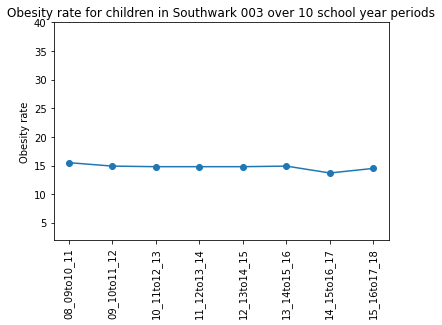

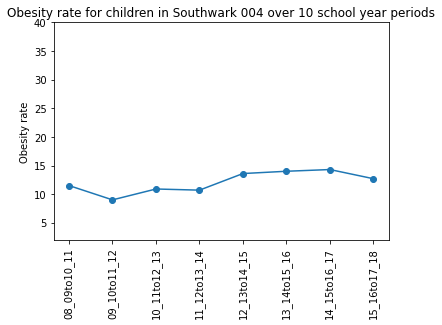

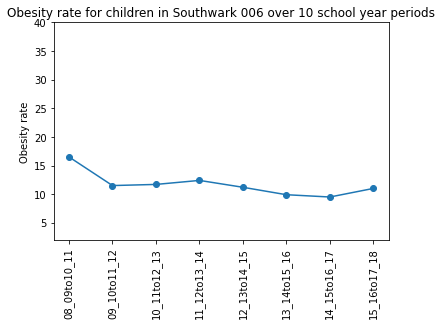

...

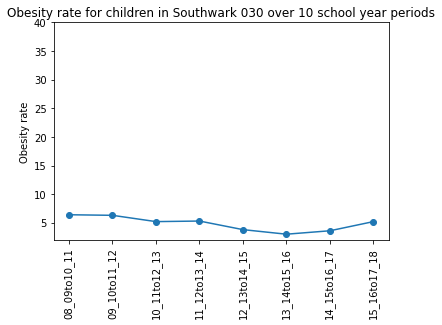

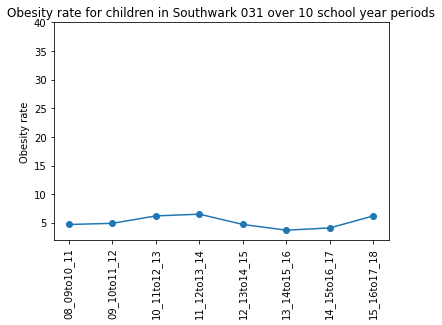

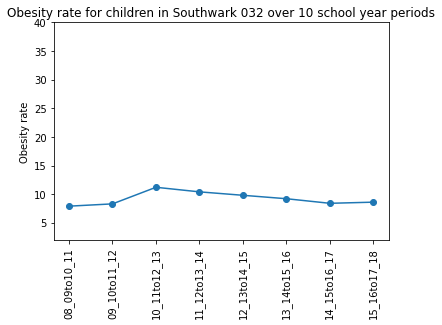

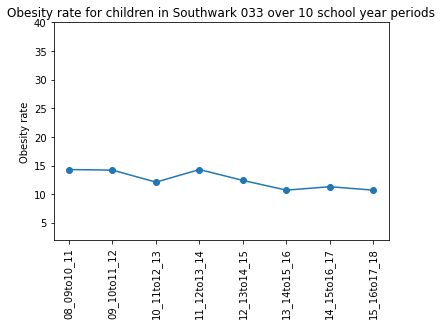

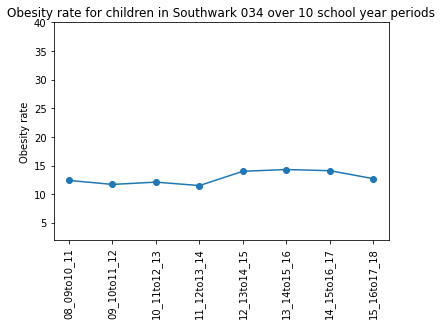

In [56]:
plot_msoa_timeline(reception, 'Southwark')

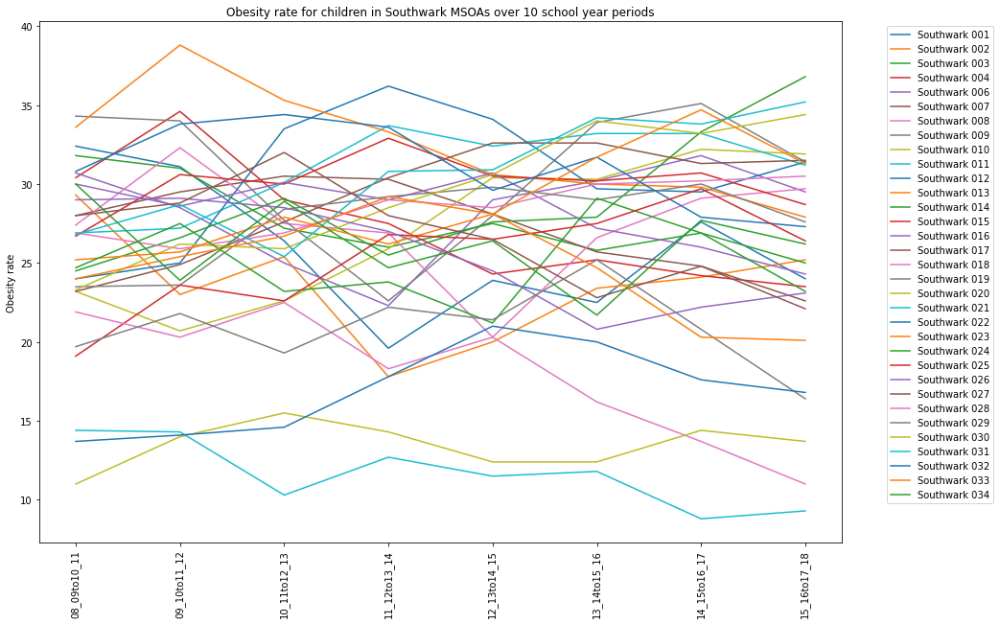

In [57]:
plot_timeline(year6, 'Southwark')

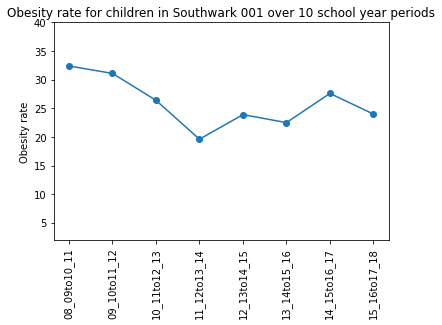

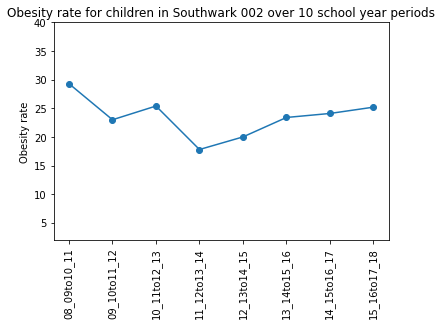

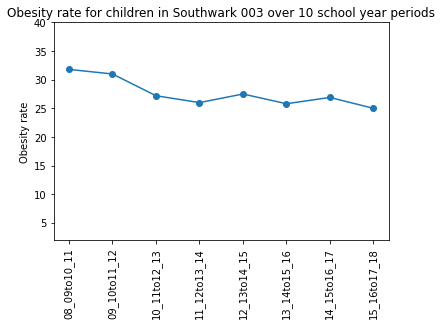

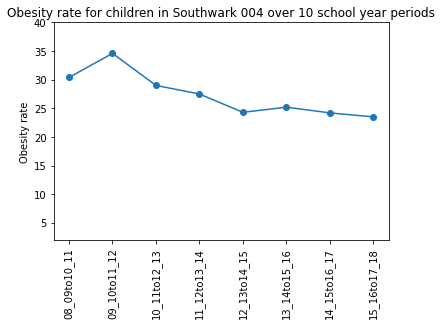

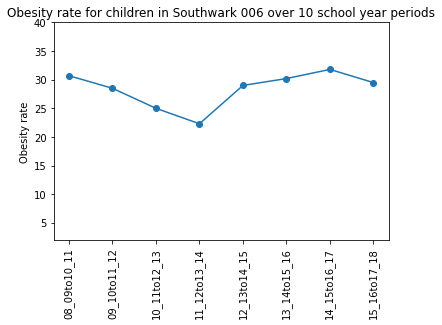

...

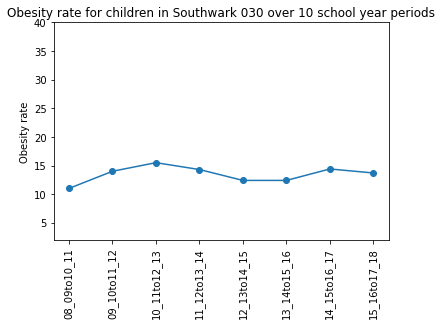

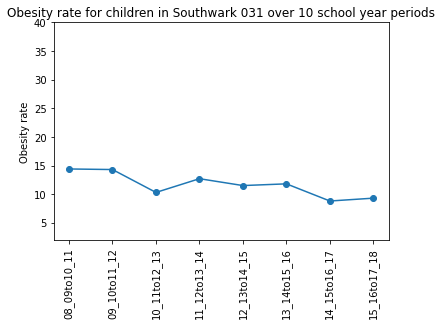

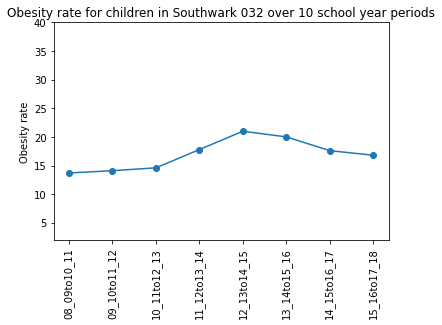

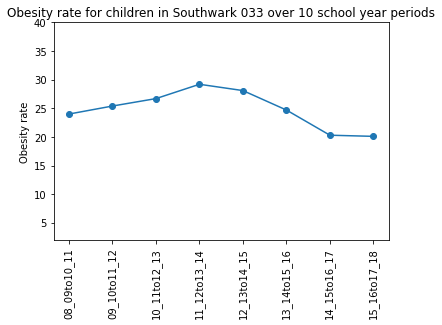

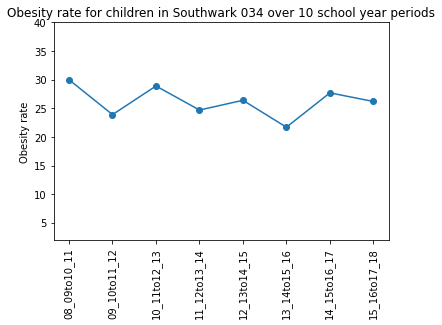

In [58]:
plot_msoa_timeline(year6, 'Southwark')

#### Observations for Year 6 in Southwark MSOAs:

Individual plots worth noting are:
    - Southwark 001 had a significant drop in the first 4 periods
    - Southwark 009 had a steep drop and hike between periods 2 and 6
    - Southwark 010, 014, 020, 021, 025 had a steady and important deterioration (~10%) over the periods
    - Southwark 012 had a large hike during periods 2 to 4
    - Southwark 026 had a steady improvement
    - Southwark 028 had a steady and important improvement over all periods

Next steps:
    - Confirm statistical significance of the observations above.
    - Investigate potential factors/cause of the above observations.
   

### 3. Conclusions and next steps

The visualisations have generated some initial observations and highlighted particular areas that should be investigated further. However, these observations are approximate in their nature and we need further statistical analysis to identify which of the variations over time are statistically significant.

We can also isolate the MSOAs that have shown the most significant improvements & deteriorations over the full time period and attempt find potential factors for this in the sociodemographic datasets.

In [59]:
#socio = pd.read_csv('SocioDemographicData.csv')
#socio.head(5)

In [60]:
#socio.columns

*Notes for Part 2:*

The dataset (above) by itself would be extremely interesting and worth looking into for many correlations etc... but need to focus here on impact/interaction with children obesity rates. Maybe for another project!

Look at areas with similar problems but different outcomes! Can help with causal inference and with recommendations e.g. have those areas put some special schemes in place that were particularly successful and could be reproduced?